# Introduction

This notebook is provided as a way to retrieve the data which will be used for the analysis.

## Libraries Loading

We first load all the needed libraries for the data.

In [1]:
# Import all the relevant libraries
from   bs4                   import BeautifulSoup
from   collections           import Counter
import inflect
from   joblib                import Parallel, delayed
import matplotlib.pyplot     as     plt
from   natsort               import natsorted
import numpy                 as     np
import os
import pandas                as     pd
from   pytrends.request      import TrendReq
from   random                import seed
import requests
import seaborn               as     sns
import time
from   tqdm.notebook         import tqdm
from   wordcloud             import WordCloud, get_single_color_func

plt.rcParams["figure.dpi"] = 150
plt.rcParams["figure.figsize"] = (8,4)
plt.style.use("bmh")
plt.rcParams["lines.linewidth"] = 1.0
# Extra code to use latex
plt.rcParams["text.usetex"]=True
plt.rc('text.latex', preamble=r'\usepackage{amsfonts}')
plt.rcParams["font.family"] = "cm"

# Setting the visualization parameters
plt.rcParams["figure.dpi"] = 300
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["figure.figsize"] = (10,5)
# Setting the random seeds to guarantee reproducibility of the results
np.random.seed(2023)
seed(2023)

output_folder = "../output"
# Make the output folder where we will save the plots
os.makedirs(output_folder, exist_ok=True)

### Google ML Glossary Data Parsing
Next, we will use the `request` library to retrieve the glossary page and `bs4` to parse it in order to obtain the keywords.

## Keyword Retrieval

In [2]:
# 0. request the page from the google link
html_output = requests.get("https://developers.google.com/machine-learning/glossary")
# 1. parse and find all the relevant keywords
soup = BeautifulSoup(html_output.content, "html.parser").find_all("h2")
# 2. get all the keywords from the soup structure and remove spaces
keywords_google = list(map(lambda x: x.get("data-text").strip(), soup))
# 3. filter out keywords with only one character
keywords_google = list(filter(lambda x: len(x)>1, keywords_google))
# 4. make the beginning of each word a capital letter
keywords_google = list(map(lambda x: x.title() , keywords_google))
# 5. Show how many words are included in the set and display a 10-word sample
print(f"The Google word set contains {len(keywords_google)} words")
ten_word_sample = np.array(keywords_google)[np.random.permutation(len(keywords_google))[:10]]
print(f"A 10-words sample of the Google Glossary data set is: {list(ten_word_sample)}")

The Google word set contains 571 words
A 10-words sample of the Google Glossary data set is: ['Pmap', 'Bias (Math) Or Bias Term', 'Training-Serving Skew', 'Spatial Pooling', 'Categorical Data', 'Ar', 'Tensorboard', 'Tpu', 'Discriminator', 'Token']


A list of words makes it hard to understand what the real content looks like. A word cloud may help in making the visualization a little easier.

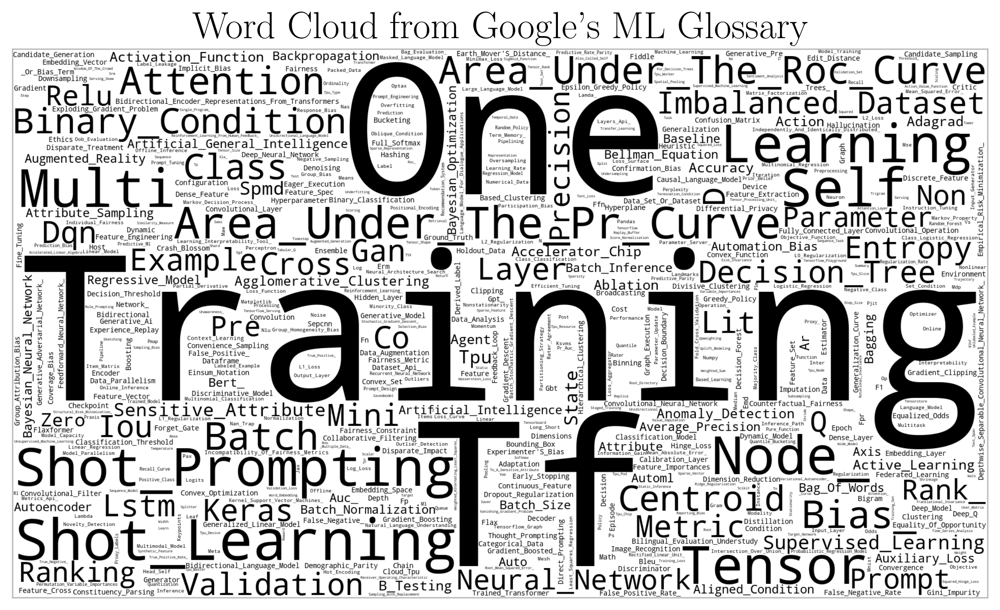

In [3]:
# To make the wordcloud black, we referred to
# https://towardsdatascience.com/how-to-make-word-clouds-in-python-that-dont-suck-86518cdcb61f
def black_color_func(word, font_size, position, orientation, random_state=None, **kwargs):
    """
    This function sets the color for the keywords in the word cloud
    """
    return "black"
    
def plotWordCloud(text, title, outputFilename):
    """
    This function is a wrapper to plot word clouds.
    Inputs:
    - text: the text to be used for plotting
    - title : the title of the image
    - outputFilename : the filename the output image is going to be saved in
    """

    wc = WordCloud(background_color="white", max_words=2000, contour_width=2, contour_color='black',
                  width=1920, height=1080, random_state=2023, color_func=black_color_func)
    text = [words.strip().replace(" ","_") for words in text]
    wc.generate(" ".join(text))
    plt.imshow(wc, interpolation="bilinear")
    plt.title(title, fontsize=22)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()
    plt.savefig(outputFilename)

# Generate the Word Cloud from Google's ML Glossary and save it to the output folder
plotWordCloud(keywords_google, "Word Cloud from Google's ML Glossary", 
              os.path.join(output_folder, "fig1_google_wordcloud.pdf"))

### ChatGPT-4 Keywords
[OpenAI's ChatGPT](https://openai.com/blog/chatgpt) is a Large Language Model (LLM) which has democratized the use of AI across large sectors of the population and triggered a broad discussion regarding privacy concerns, the role of the individual in a society where AI can accomplish human-level tasks, and fair use of training data. 

We are not interested in the generative capabilities of ChatGPT in a strict sense. However, since ChatGPT-4 is rumored to feature 1 Trillion parameters and to have been trained on several hundred gigabytes of data (with knowledge update in September 2021), we can be confident that the model must have been exposed to a sizable amount of AI literature. We therefore asked ChatGPT-4 the following question:
```
Hello ChatGPT! I am looking for a list of approximately 500 keywords of the hottest research and development 
topics in the fields of Machine Learning, Deep Learning, and Data Science. Please provide the list as a Python list structure.
```
The answer to the prompt was the following:
```
Hello! Please note that the keywords and topics in Machine Learning, Deep Learning, and Data Science are always evolving. As of my last knowledge update in September 2021, the following list contains some of the popular topics and keywords in those fields. However, I recommend consulting recent literature and conferences for the most up-to-date topics.

Here's a Python list of around 500 keywords and phrases:
```

In [4]:
keywords_chatgpt = [
    "Artificial Intelligence",
    "Machine Learning",
    "Deep Learning",
    "Neural Networks",
    "Convolutional Neural Networks",
    "Recurrent Neural Networks",
    "Long Short-Term Memory Networks",
    "Generative Adversarial Networks",
    "Transfer Learning",
    "Reinforcement Learning",
    "Q-Learning",
    "Deep Q-Networks",
    "Natural Language Processing",
    "Text Classification",
    "Sentiment Analysis",
    "Sequence Modeling",
    "Word Embeddings",
    "Word2Vec",
    "GloVe",
    "BERT",
    "Transformer Models",
    "Attention Mechanism",
    "Image Classification",
    "Object Detection",
    "Image Segmentation",
    "Face Recognition",
    "Autoencoders",
    "Variational Autoencoders",
    "Data Augmentation",
    "Feature Engineering",
    "Feature Selection",
    "Hyperparameter Tuning",
    "Grid Search",
    "Random Search",
    "Bayesian Optimization",
    "Ensemble Learning",
    "Bootstrap Aggregating",
    "Gradient Boosting",
    "XGBoost",
    "LightGBM",
    "CatBoost",
    "Support Vector Machines",
    "Decision Trees",
    "Random Forests",
    "K-Nearest Neighbors",
    "Clustering",
    "K-Means",
    "DBSCAN",
    "Hierarchical Clustering",
    "Anomaly Detection",
    "Principal Component Analysis",
    "Linear Regression",
    "Logistic Regression",
    "Regularization",
    "L1 Regularization",
    "L2 Regularization",
    "Data Cleaning",
    "Data Transformation",
    "Data Visualization",
    "Time Series Analysis",
    "ARIMA",
    "Forecasting",
    "Multiclass Classification",
    "Binary Classification",
    "Evaluation Metrics",
    "Accuracy",
    "Precision",
    "Recall",
    "F1 Score",
    "ROC Curve",
    "AUC-ROC",
    "Confusion Matrix",
    "Big Data",
    "Hadoop",
    "Spark",
    "NoSQL",
    "MongoDB",
    "Cassandra",
    "Data Warehousing",
    "ETL",
    "SQL",
    "Data Lakes",
    "TensorFlow",
    "Keras",
    "PyTorch",
    "scikit-learn",
    "Jupyter",
    "Matplotlib",
    "Seaborn",
    "Pandas",
    "Numpy",
    "SciPy",
    "Bias-Variance Tradeoff",
    "Overfitting",
    "Underfitting",
    "Cross-Validation",
    "Deep Reinforcement Learning",
    "Policy Gradients",
    "Actor-Critic Methods",
    "Monte Carlo Methods",
    "Evolutionary Algorithms",
    "Genetic Algorithms",
    "Particle Swarm Optimization",
    "Explainable AI",
    "Interpretable Machine Learning",
    "Adversarial Attacks",
    "Model Robustness",
    "Data Privacy",
    "Differential Privacy",
    "Federated Learning",
    "Synthetic Data Generation",
    "Data Imputation",
    "Missing Data",
    "Data Labeling",
    "Crowdsourcing",
    "Data Bias",
    "Fairness in Machine Learning",
    "Responsible AI",
    "AI Ethics",
    "GANs for Data Augmentation",
    "GANs for Art Generation",
    "Neural Style Transfer",
    "Image Super-Resolution",
    "Optical Character Recognition",
    "Speech Recognition",
    "Speech Synthesis",
    "Text-to-Speech",
    "Voice Assistants",
    "Chatbots",
    "Information Retrieval",
    "Search Algorithms",
    "Graph Neural Networks",
    "Recommendation Systems",
    "Collaborative Filtering",
    "Content-Based Filtering",
    "Matrix Factorization",
    "AI in Healthcare",
    "AI in Finance",
    "AI in Retail",
    "AI in Manufacturing",
    "Robotics Process Automation",
    "Computer Vision",
    "Edge AI",
    "IoT and AI",
    "Smart Cities",
    "Self-driving Cars",
    "Human Activity Recognition",
    "Language Translation",
    "Multilingual Models",
    "AI in Agriculture",
    "AI for Social Good",
    "Bias Correction",
    "Data Synthesis",
    "Data Compression",
    "Feature Extraction",
    "Dimensionality Reduction",
    "t-SNE",
    "UMAP",
    "OpenAI",
    "DeepMind",
    "Active Learning",
    "Meta Learning",
    "Few-Shot Learning",
    "One-Shot Learning",
    "Zero-Shot Learning",
    "Semi-Supervised Learning",
    "Unsupervised Learning",
    "Out-of-Distribution Detection",
    "Data Efficiency",
    "Scalable AI",
    "Neural Architecture Search",
    "Efficient Neural Networks",
    "Knowledge Distillation",
    "Model Compression",
    "Quantization",
    "Model Pruning",
    "Transferable Features",
    "Multi-modal Learning",
    "Cross-modal Learning",
    "Self-Supervised Learning",
    "Contrastive Learning",
    "Knowledge Graphs",
    "Data Integration",
    "Data Fusion",
    "Data Matching",
    "Link Prediction",
    "Graph Mining",
    "Spatial Data Science",
    "Geospatial Analysis",
    "Remote Sensing",
    "Satellite Imagery Analysis",
    "AI in Earth Sciences",
    "Climate Modeling",
    "Audio Signal Processing",
    "Music Generation",
    "Sound Synthesis",
    "Audio Classification",
    "Audio Source Separation",
    "Emotion Recognition",
    "Mental Health and AI",
    "Mobile AI",
    "Hardware Accelerators",
    "Quantum Machine Learning",
    "Neuromorphic Computing",
    "Privacy-Preserving AI",
    "Data Governance",
    "Data Quality",
    "Data Lineage",
    "Real-time Analytics",
    "Streaming Data",
    "Customer Analytics",
    "User Behavior Analytics",
    "Market Basket Analysis",
    "Churn Prediction",
    "Fraud Detection",
    "Anomaly Detection in Time Series",
    "Predictive Maintenance",
    "Image Captioning",
    "Video Analysis",
    "Video Object Tracking",
    "Pose Estimation",
    "Action Recognition",
    "Generative Pre-trained Transformer",
    "OpenAI GPT Models",
    "CycleGAN",
    "StyleGAN",
    "Knowledge Transfer",
    "Imbalanced Data",
    "Synthetic Minority Over-sampling Technique",
    "Bias in NLP",
    "NLP for Low-resource Languages",
    "Customer Sentiment Analysis",
    "Automated Machine Learning",
    "Neuro-Linguistic Programming",
    "AI Governance",
    "Algorithmic Bias",
    "Blockchain and AI",
    "AI in Cybersecurity",
    "Intrusion Detection Systems",
    "Malware Detection",
    "Explainable Deep Learning",
    "Saliency Maps",
    "Attention Maps",
    "Virtual Reality and AI",
    "Augmented Reality and AI",
    "Human-in-the-loop Machine Learning",
    "Domain Adaptation",
    "Multi-task Learning",
    "Parallel and Distributed Machine Learning",
    "High-Performance Machine Learning",
    "Causal Inference",
    "AI in Drug Discovery",
    "AI in Genomics",
    "Medical Image Analysis",
    "Healthcare Predictive Analytics",
    "Multi-agent Systems",
    "Game Theory and AI",
    "AI in Robotics",
    "Robotic Process Automation",
    "Simultaneous Localization and Mapping",
    "Conversational AI",
    "Question Answering Systems",
    "Summarization Models",
    "Large Language Models",
    "Information Extraction",
    "Named Entity Recognition",
    "Relation Extraction",
    "AI in Education",
    "Personalized Learning",
    "Educational Data Mining",
    "Learning Analytics",
    "AI in Gaming",
    "Procedural Content Generation",
    "Game Playing AI",
    "Motion Planning",
    "Motion Capture",
    "Biometrics and AI",
    "Fingerprint Recognition",
    "Iris Recognition",
    "Document Analysis",
    "Topic Modeling",
    "Latent Dirichlet Allocation",
    "Mixed Reality and AI"
]
print(f"The ChatGPT word set contains {len(keywords_chatgpt)} words")
ten_word_sample = np.array(keywords_chatgpt)[np.random.permutation(len(keywords_chatgpt))[:10]]
print(f"A 10-words sample of the ChatGPT4 data set is: {list(ten_word_sample)}")

The ChatGPT word set contains 283 words
A 10-words sample of the ChatGPT4 data set is: ['Data Transformation', 'OpenAI', 'Self-Supervised Learning', 'Ensemble Learning', 'AI in Retail', 'Audio Signal Processing', 'DeepMind', 'Multi-agent Systems', 'Customer Sentiment Analysis', 'Data Quality']


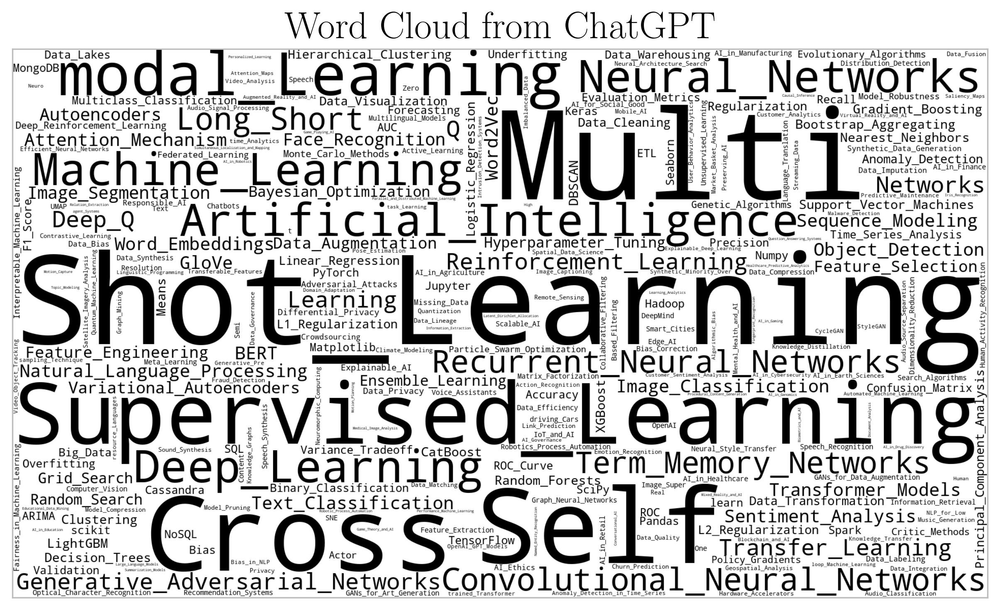

In [5]:
plotWordCloud(keywords_chatgpt, "Word Cloud from ChatGPT", os.path.join(output_folder, "fig2_chatgpt_wordcloud.pdf"))

### Web Of Science
We also conducted a research on [Web of Science](https://www.webofscience.com/wos/woscc/summary/a85acf74-ea4b-4b5c-a110-4fedfaaa290c-90a06fd8/relevance/1) by querying all the articles relating to either *Machine Learning*, *Deep Learning* or *Data Science*. As the number of the articles was in the order of millions, we restricted the search by filtering only the "hot papers", a definition indicating papers which have been cited a much larger number of times than those in the same category release in approximately the same time frame. This query resulted in the selection of 1081 papers, of which we obtained the keywords, included in `wos_kw.txt`. We will parse this file in order to process the keywords appropriately.

Web of Science word set contains 6065 words
A 10-words sample of the Web of Science data set is: ['Scattering', 'Quantile Regression', 'Hydro Energy', 'Solid Modeling', 'Metaanalyses', 'Networks', 'Appendage', 'Anxiety', 'Burden', 'Loneliness']


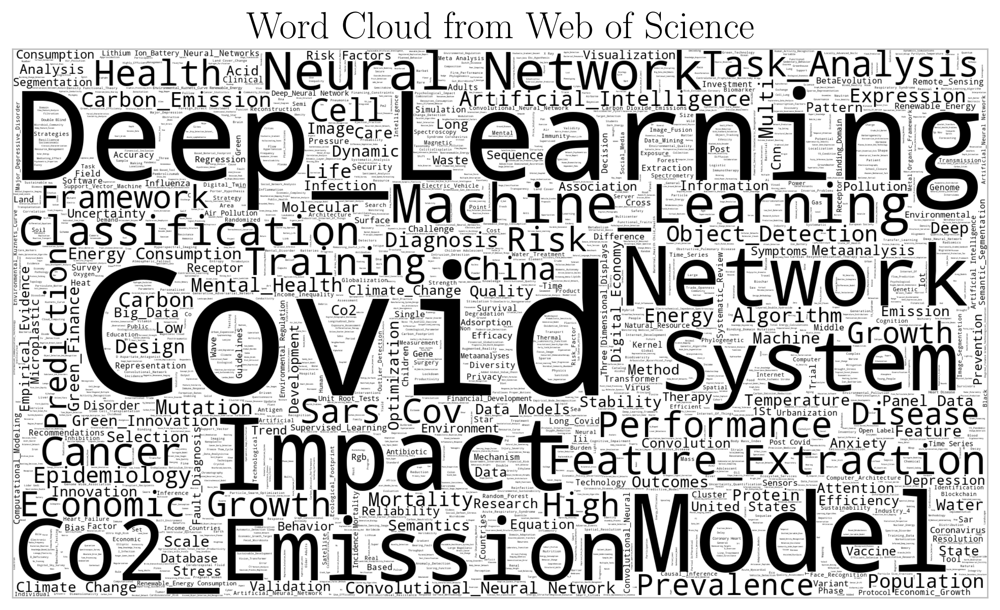

In [6]:
# Open the file
with open("../data/wos_kw.txt", "r") as file:
    wos = file.read().replace("Keywords =", "").replace("Keywords-Plus =", "").replace("{","").replace("}","").split("\n")

# Strip the lines of leading and trailing spaces, remove keywords with 0 length
wos = [element.strip().lower().title() for elements in wos for element in elements.strip().replace(",","").split(";") if len(element.strip())>0]
ten_word_sample = np.array(wos)[np.random.permutation(len(wos))[:10]]
print(f"Web of Science word set contains {len(wos)} words")
print(f"A 10-words sample of the Web of Science data set is: {list(ten_word_sample)}")
plotWordCloud(wos, "Word Cloud from Web of Science", os.path.join(output_folder, "fig3_wos_wordcloud.pdf"))

It is interesting to note that a lot of information concerns the concepts of green energy, pollution, emissions and Covid. However, these keywords do not look specific enough to the fields of Machine Learning and Deep Learning, and we therefore opt for excluding the Web of Science keywords data set altogether.

## Combining the Dictionaries

In [7]:
# Create a set of terms from Google ML Glossary and ChatGPT4. Using `set` removes the duplicates.
final_words_dictionary = list(set(keywords_google + keywords_chatgpt))

# Set up the engine for singular/plural removal
p = inflect.engine()

# Get the words which have singular/plural form
plural_counter = Counter([p.singular_noun(noun) if p.singular_noun(noun)!=False else noun for noun in final_words_dictionary]).most_common()
plural_counter = list(filter(lambda x: x[1]>1 , plural_counter))
plurals_list = list(map(lambda x: x[0],plural_counter))
print("The following words appear in the singular/plural form:")
print("\n".join(plurals_list))

# Remove the plural form of such words from the dictionary
for word in plurals_list:
    final_words_dictionary.remove(word+"s")
    print(f"Removed...{word+'s'}")

The following words appear in the singular/plural form:
Neural Network
Recommendation System
Recurrent Neural Network
Random Forest
Large Language Model
Word Embedding
Autoencoder
Convolutional Neural Network
Decision Tree
Removed...Neural Networks
Removed...Recommendation Systems
Removed...Recurrent Neural Networks
Removed...Random Forests
Removed...Large Language Models
Removed...Word Embeddings
Removed...Autoencoders
Removed...Convolutional Neural Networks
Removed...Decision Trees


In [8]:
outputFile =  "../data/final_dictionary.txt" 
with open(outputFile, "w") as file:
    file.writelines("\n".join(final_words_dictionary))
print(f"Final dictionary output written to: {outputFile}")
print(f"Length of Final Dictionary : {len(final_words_dictionary)} words")

Final dictionary output written to: ../data/final_dictionary.txt
Length of Final Dictionary : 802 words


With a total of 802 words, we can proceed with the time series data set creation by querying Google Trends using a Python API.

## Obtaining the data from Google Trends

In this section, we will obtain the data from Google Trends for the USA. If the trend data is available in `../data/google_trends_data.csv` file, then Google Trend is not queried and the local file is used instead. We will attach the time series file to this script so that the grader will not need to wait for the time series download.

The way Google Trends collects and stores its data provides a justification for its use, and we therefore deem it essential to explain it here. The data processing for Google trends proceeds as follows:

1. Every time a user performs a search on Google, this search prompt is stored and segmented into keywords (note that keywords can possibly be even bigrams or trigrams).
1. The keywords search counts are binned into time intervals and divided by the total amount of keywords searched during such time interval (this is the normalization step).
1. The normalized count is then rescaled between 0 and 100, so that a keyword which has been searched a lot relatively to other keywords is given the value 100 and a keyword which has not been searched at all is given the value of 0.

This way of processing the data implies that, although we do not have access to the raw counts for the searched keywords, we can still compare the search frequencies for different keywords and draw some insights.

In [9]:
# specify the file to look for
datafile = "../data/fulldata.csv"
if not os.path.isfile(datafile):

    # create data folder if it does not exist
    os.makedirs("/".join(datafile.split("/")[:-1]), exist_ok=True)
    
    # set up a list of data frames
    dfs = []

    # set up a pytrends query
    pyquery = TrendReq(hl='en-US', tz=60) # London Summer Time

    for i in tqdm(range(0,len(final_words_dictionary), 5)):
        kws = final_words_dictionary[i:i+5]
        pyquery.build_payload(kws, cat=0, timeframe='today 5-y', geo='', gprop='')
        df = pyquery.interest_over_time()
        # append the df
        dfs.append(df)
        # sleep 2.5 seconds
        time.sleep(2.5)

    df = pd.concat([element.iloc[:,:-1] for element in dfs], axis=1)
    df.to_csv(datafile)
    
# then read the data frame
df = pd.read_csv(datafile, index_col=0)/100.0
df = df.loc[:, natsorted(list(df.columns))]
df = df.loc[:"2022-12-15",:].iloc[-60:,:].copy()

# get the number of columns
n_time_series = df.shape[1]

## Time Series Plot

First, we create a plot of all time series.

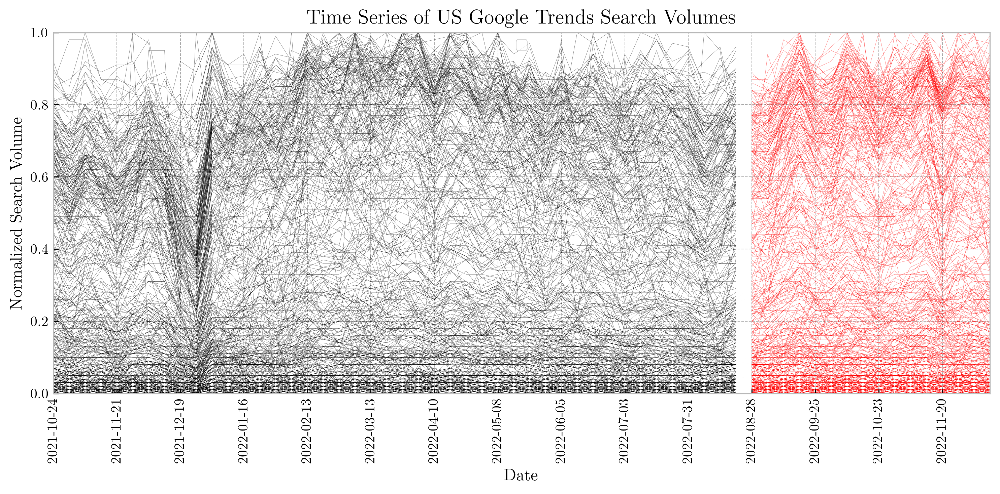

In [10]:
# Set the number of weeks for test set
n_test = 16
df_train, df_test = df.iloc[:-n_test,:].copy() , df.iloc[-n_test:,:].copy()
X_train, X_test = df_train.values, df_test.values

# Number of input/test steps
n_in = n_test
n_out = n_test

# Plot training and test set
plt.plot(df_train.iloc[:,0], color="k", alpha=0.5, lw=0.2, label="training");
plt.plot(df_test.iloc[:,0], color="r", alpha=0.5, lw=0.2, label="test");
plt.plot(df_train.iloc[:,1:], color="k", alpha=0.5, lw=0.2);
plt.plot(df_test.iloc[:,1:], color="r", alpha=0.5, lw=0.2);

plt.ylim([0,1])
plt.xlim([df.index[0], df.index[-1]])
plt.legend(bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=2)
plt.xlabel("Date")
plt.ylabel("Normalized Search Volume")
plt.title("Time Series of US Google Trends Search Volumes")
plt.legend("")
plt.xticks(df.index[::4], rotation=90)
plt.tight_layout()

os.makedirs("../img", exist_ok=True)
plt.savefig("../img/fig6_allsearches.pdf")

In [11]:
# specify the file to look for
datafile = "../data/google_trends_data.csv"
if not os.path.isfile(datafile):
    # obtain the dates we need and filter out the unnecessary data
    df = df.iloc[:,(df.iloc[:-16,:].max()-df.iloc[:-16,:].min()).values > 0.1]
    # save such data set 
    (df*100.0).astype(int).to_csv(datafile)
else:
    df = pd.read_csv(datafile, index_col=0).loc[:"2022-12-15",:].iloc[-60:,:]/100

The file exported to `../data/google_trends_data.csv` represents the data which we will use for training, and this export completes the notebook. <br>
Then plot again the reduced data set.

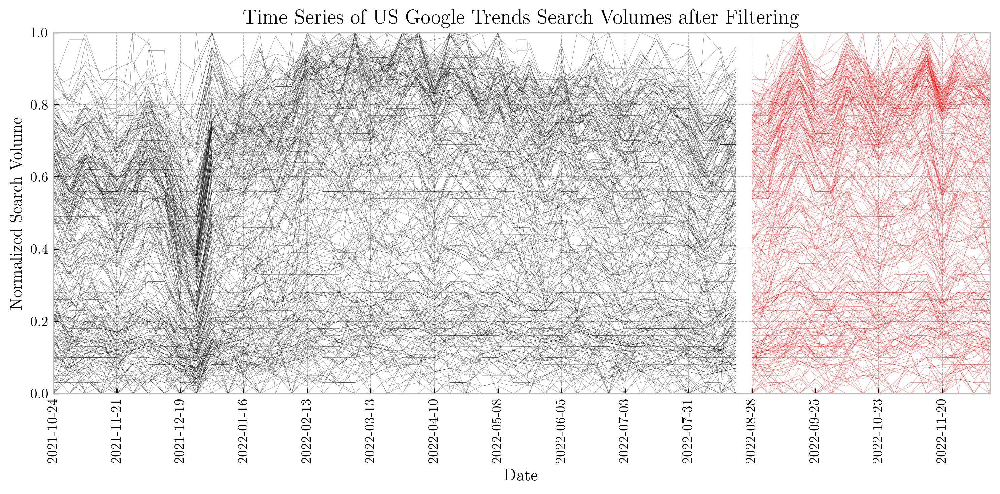

In [12]:
# Set the number of weeks for test set
n_test = 16
df_train, df_test = df.iloc[:-n_test,:].copy() , df.iloc[-n_test:,:].copy()
X_train, X_test = df_train.values, df_test.values

# Number of input/test steps
n_in = n_test
n_out = n_test

# Plot training and test set
plt.plot(df_train.iloc[:,0], color="k", alpha=0.5, lw=0.2, label="training");
plt.plot(df_test.iloc[:,0], color="r", alpha=0.5, lw=0.2, label="test");
plt.plot(df_train.iloc[:,1:], color="k", alpha=0.5, lw=0.2);
plt.plot(df_test.iloc[:,1:], color="r", alpha=0.5, lw=0.2);

plt.ylim([0,1])
plt.xlim([df.index[0], df.index[-1]])
plt.legend(bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=2)
plt.xlabel("Date")
plt.ylabel("Normalized Search Volume")
plt.title("Time Series of US Google Trends Search Volumes after Filtering")
plt.legend("")
plt.xticks(df.index[::4], rotation=90)
plt.tight_layout()

os.makedirs("../img", exist_ok=True)
plt.savefig("../img/fig6_allsearches_filtered.pdf")

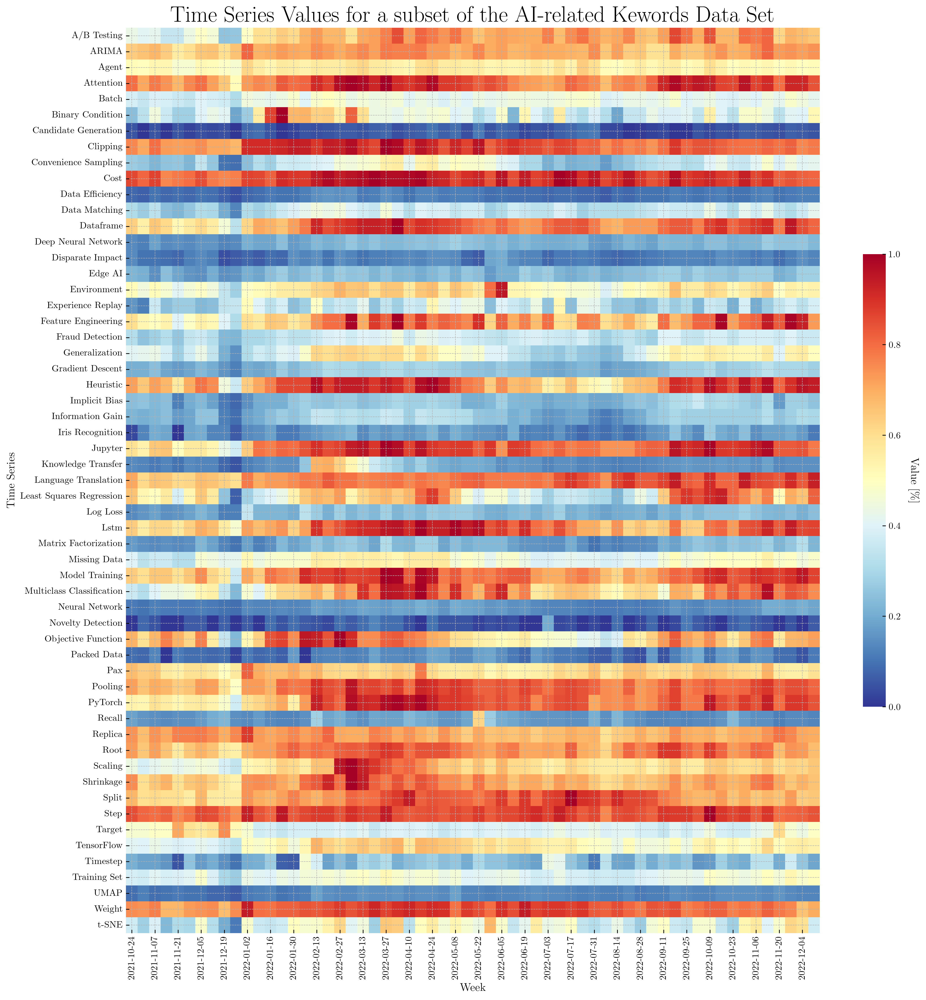

In [13]:
# Plot all time series via a heatmap
plt.figure(figsize = (15,15))
plt.title('Time Series Values for a subset of the AI-related Kewords Data Set', fontsize=24)
cbar = sns.heatmap(df.iloc[:,::5].T, cmap='RdYlBu_r', cbar_kws={"shrink": 0.5}).collections[0].colorbar
cbar.set_label('Value [\%]', rotation=270, labelpad=20)
plt.xlabel('Year-Month')
plt.ylabel('Time Series');
plt.xlabel("Week");
xticks = plt.gca().get_xticks();
plt.gca().set_xticks(xticks[::2])

plt.tight_layout();
plt.savefig("../img/fig8_timeseries_all_plot.pdf")

And this completes the time series pre-processing and plotting.